### Step 3

In [38]:
import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/afscomercial/weather_clustering/refs/heads/main/data.csv')

In [16]:
# Uing Plotly for plotting
import plotly.express as px

# List of continuous columns
continuous_columns = ['temp', 'visibility', 'dew_point', 'feels_like', 'temp_min', 
                      'temp_max', 'pressure', 'humidity', 'wind_speed', 'wind_deg', 
                      'wind_gust', 'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds_all']

# histograms 
# also showing the outliers
for col_name in continuous_columns:
    fig = px.histogram(df, x=col_name, title=f'Data distribution of {col_name}',marginal="box", nbins=100)
    fig.show()

In [17]:
# Plot box plots for continuous columns
for col in continuous_columns:
    fig = px.box(df, y=col, title=f'Box plot of {col}')
    fig.show()

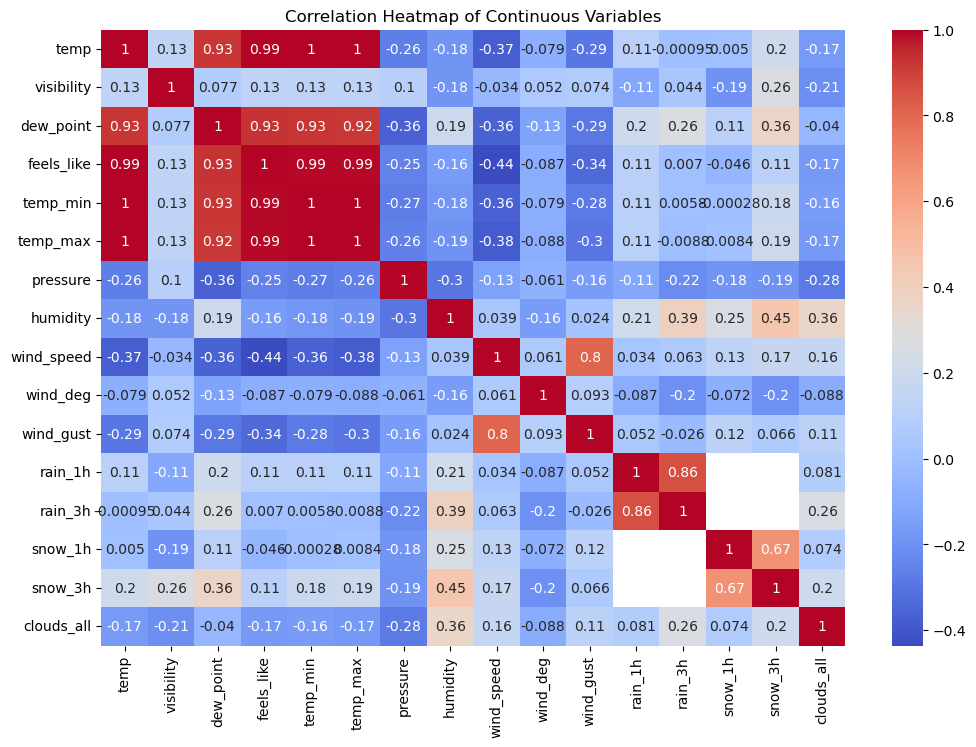

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate the correlation matrix
corr_matrix = df[continuous_columns].corr()

# heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, cmap='coolwarm', annot=True,)
plt.title('Correlation Heatmap of Continuous Variables')
plt.show()

In [39]:
# Remove the ' UTC' part from the 'dt_iso' column
df['dt_iso'] = df['dt_iso'].str.replace(' UTC', '', regex=False)

# Convert 'dt_iso' to datetime format
df['dt_iso'] = pd.to_datetime(df['dt_iso'], format='%Y-%m-%d %H:%M:%S %z')


# Create a line plot for temperature over time, using 'year' on the x-axis
fig = px.line(df, x=df['dt_iso'], y='temp', title='Temperature over Time')
fig.show()

In [40]:
# Scatter plot between temperature and humidity
fig = px.scatter(df, x='temp', y='humidity', title='Temperature vs Humidity', trendline="ols")
fig.show()

# Scatter plot between wind speed and pressure
fig = px.scatter(df, x='wind_speed', y='pressure', title='Wind Speed vs Pressure', trendline="ols")
fig.show()